In [1]:
#Import Libraries:

import numpy as np              # for data processing.
import pandas as pd             # is an extended version of "np".

import matplotlib.pyplot as plt # for data visualization.
import seaborn as sns           #  is an extended version of "plt".

import plotly.express as px     # for more appealing interactive data visualizations.

import warnings                 # for ignoring warnings.
warnings.filterwarnings('ignore')

In [2]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from imblearn.over_sampling import ADASYN
from imblearn.under_sampling import TomekLinks
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.linear_model import SGDClassifier
from minepy import MINE

In [3]:
df = pd.read_csv("dataset/Employee_Attrition.csv")
df.head(10).style.background_gradient(cmap="Reds")


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,Y,No,23,4,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Y,Yes,15,3,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Y,Yes,11,3,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,Y,No,12,3,4,80,1,6,3,3,2,2,2,2
5,32,No,Travel_Frequently,1005,Research & Development,2,2,Life Sciences,1,8,4,Male,79,3,1,Laboratory Technician,4,Single,3068,11864,0,Y,No,13,3,3,80,0,8,2,2,7,7,3,6
6,59,No,Travel_Rarely,1324,Research & Development,3,3,Medical,1,10,3,Female,81,4,1,Laboratory Technician,1,Married,2670,9964,4,Y,Yes,20,4,1,80,3,12,3,2,1,0,0,0
7,30,No,Travel_Rarely,1358,Research & Development,24,1,Life Sciences,1,11,4,Male,67,3,1,Laboratory Technician,3,Divorced,2693,13335,1,Y,No,22,4,2,80,1,1,2,3,1,0,0,0
8,38,No,Travel_Frequently,216,Research & Development,23,3,Life Sciences,1,12,4,Male,44,2,3,Manufacturing Director,3,Single,9526,8787,0,Y,No,21,4,2,80,0,10,2,3,9,7,1,8
9,36,No,Travel_Rarely,1299,Research & Development,27,3,Medical,1,13,3,Male,94,3,2,Healthcare Representative,3,Married,5237,16577,6,Y,No,13,3,2,80,2,17,3,2,7,7,7,7


In [4]:
c=df.corr(numeric_only=True)[["DailyRate","Age"]]
c

,DailyRate,Age
Age,0.010661,1.000000
DailyRate,1.000000,0.010661
DistanceFromHome,-0.004985,-0.001686
Education,-0.016806,0.208034
EmployeeCount,NaN,NaN
EmployeeNumber,-0.050990,-0.010145
EnvironmentSatisfaction,0.018355,0.010146
HourlyRate,0.023381,0.024287
JobInvolvement,0.046135,0.029820
JobLevel,0.002966,0.509604


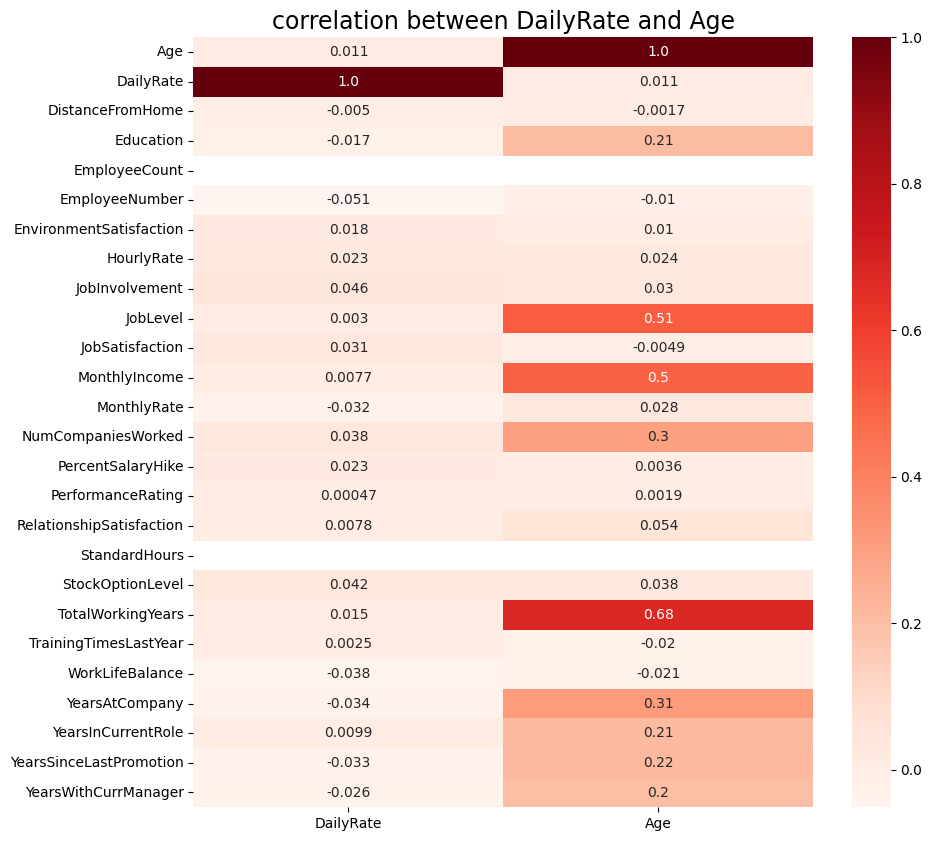

In [5]:
plt.figure(figsize=(10,10))
sns.heatmap(c,annot=True,fmt=".2",cmap="Reds")
plt.title("correlation between DailyRate and Age",c="k",fontsize=17)
plt.show()

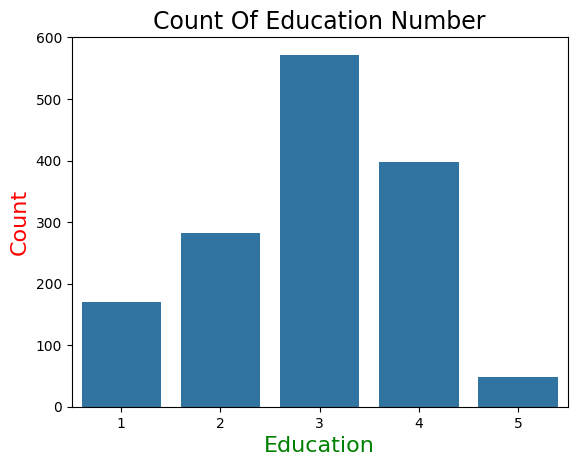

In [6]:
sns.countplot(x="Education",data=df)
plt.title("Count Of Education Number",c="k",fontsize=17)
plt.xlabel("Education",c="g",fontsize=16)
plt.ylabel("Count",c="r",fontsize=16)
plt.show()

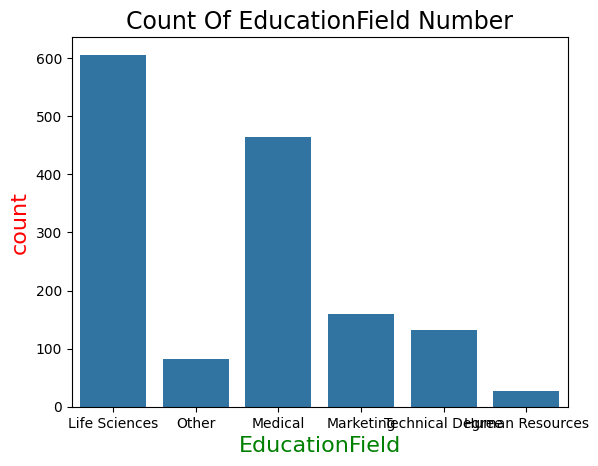

In [7]:
sns.countplot(x="EducationField",data=df)
plt.title("Count Of EducationField Number",c="k",fontsize=17)
plt.xlabel("EducationField",c="g",fontsize=16)
plt.ylabel("count",c="r",fontsize=16)
plt.show()

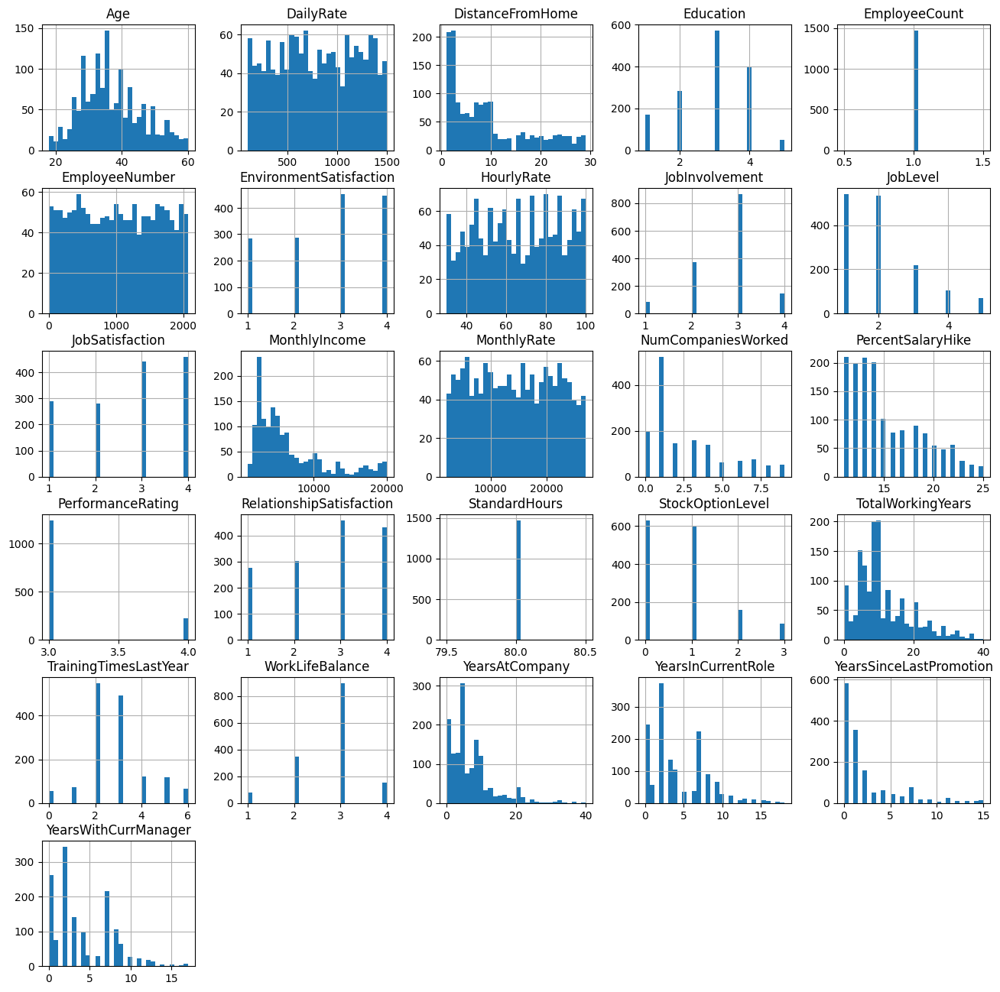

In [8]:
df.hist(bins=30,figsize=(16,16))
plt.show()

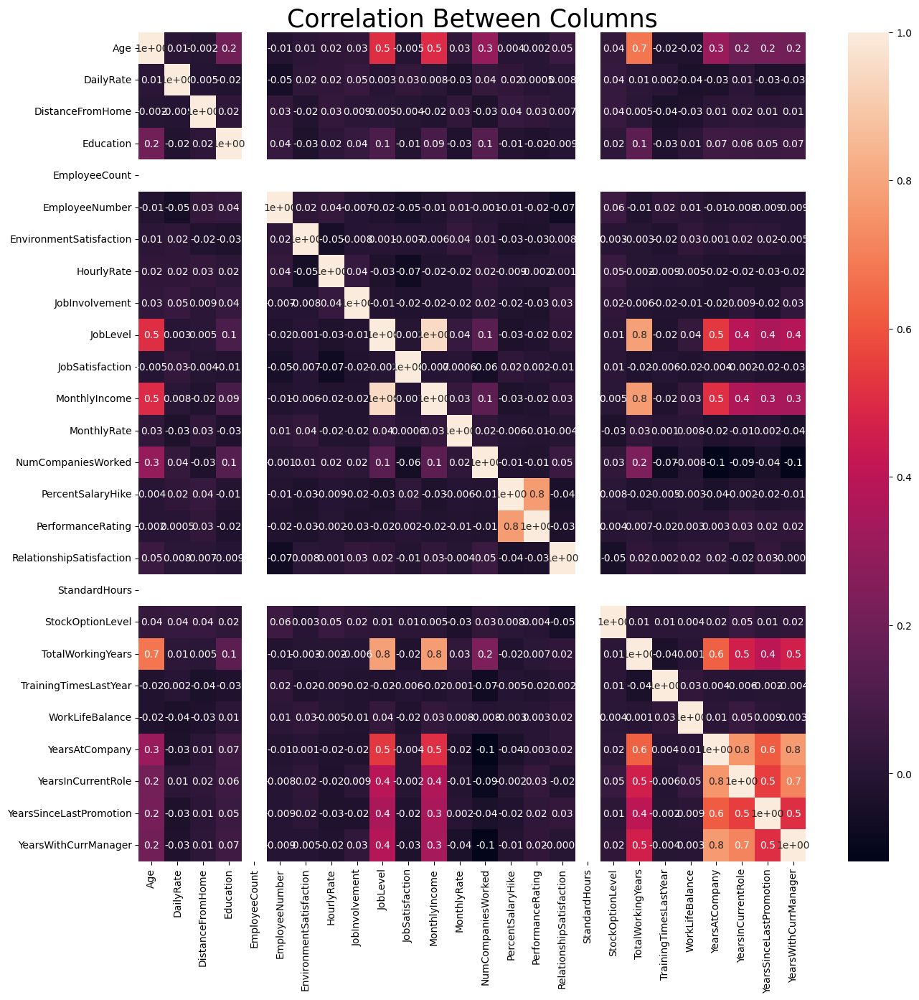

In [9]:
plt.figure(figsize=(15,15))
sns.heatmap(df.corr(numeric_only=True),annot=True,fmt=".1")
plt.title("Correlation Between Columns",c="k",fontsize=25)
plt.show()

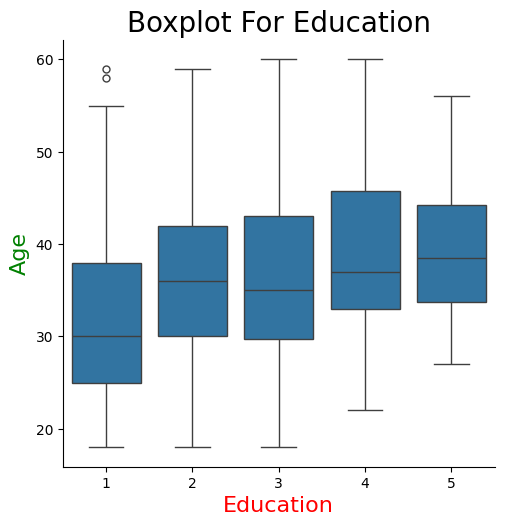

In [10]:
sns.catplot(x="Education",y="Age",data=df,kind="box")
plt.title("Boxplot For Education",c="k",fontsize=20)
plt.xlabel("Education",c="r",fontsize=16)
plt.ylabel("Age",c="g",fontsize=16)
plt.show()

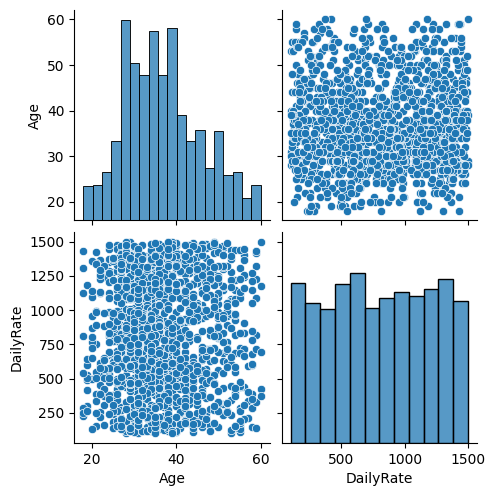

In [11]:
sns.pairplot(df,vars=["Age","DailyRate"])
plt.show()

Text(0, 0.5, 'DailyRate')

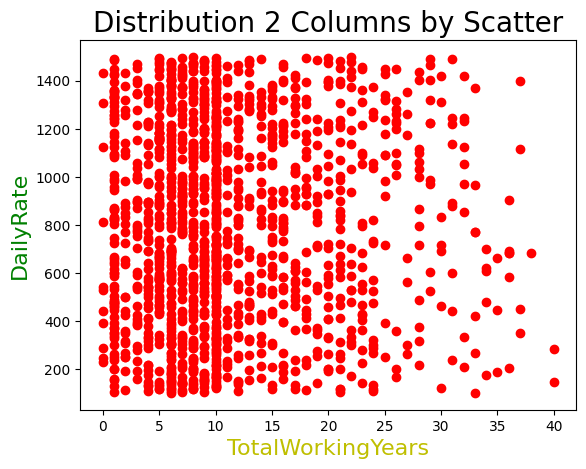

In [12]:

plt.scatter(x=df["TotalWorkingYears"],y=df["DailyRate"],c="r")
plt.title("Distribution 2 Columns by Scatter",c="k",fontsize=20)
plt.xlabel("TotalWorkingYears",c="y",fontsize=16)
plt.ylabel("DailyRate",c="g",fontsize=16)

Text(0, 0.5, 'Age')

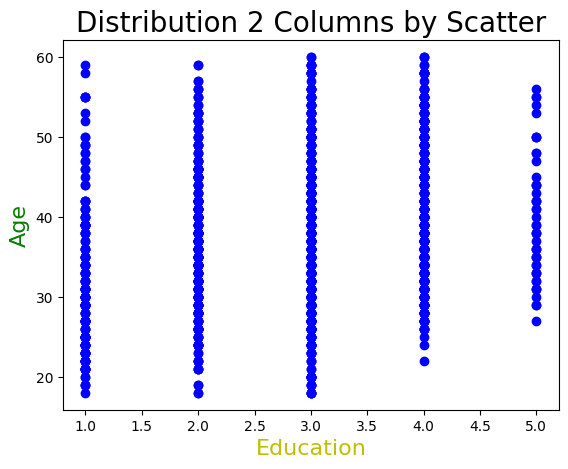

In [13]:
plt.scatter(x=df["Education"],y=df["Age"],c="b")
plt.title("Distribution 2 Columns by Scatter",c="k",fontsize=20)
plt.xlabel("Education",c="y",fontsize=16)
plt.ylabel("Age",c="g",fontsize=16)

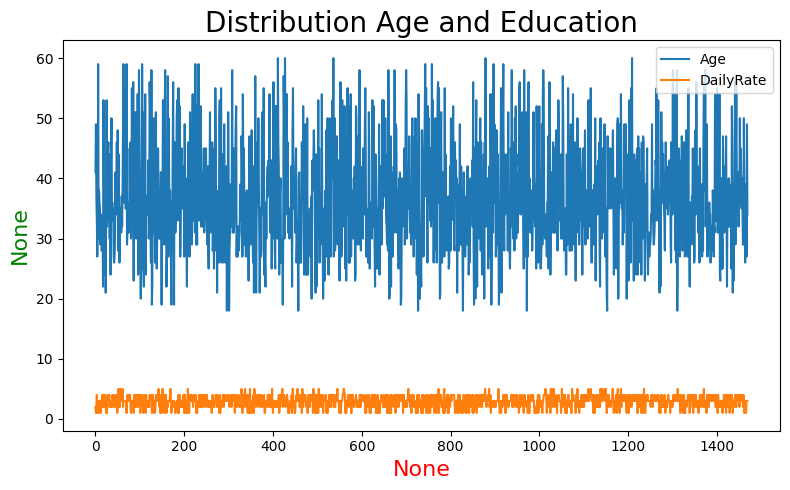

In [14]:
plt.figure(figsize=(8,5))
df["Age"].plot()
df["Education"].plot()
plt.title("Distribution Age and Education",c="k",fontsize=20)
plt.xlabel("None",fontsize=16,c="r")
plt.ylabel("None",fontsize=16,c="g")
plt.legend(["Age","DailyRate"])
plt.tight_layout()
plt.show()

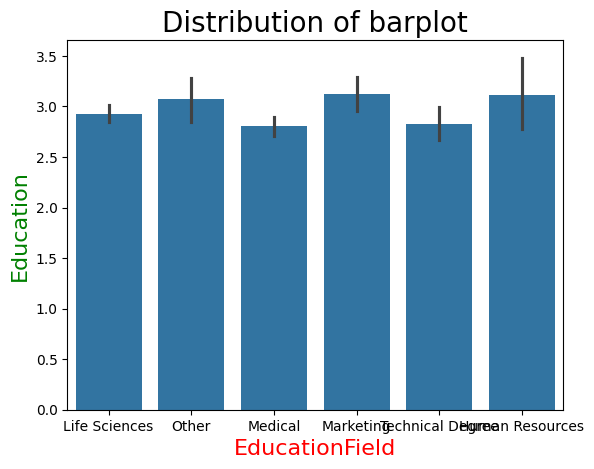

In [15]:
sns.barplot(data=df,x="EducationField",y="Education")
plt.title("Distribution of barplot",c="k",fontsize=20)
plt.xlabel("EducationField",c="r",fontsize=16)
plt.ylabel("Education",c="g",fontsize=16)
plt.show()

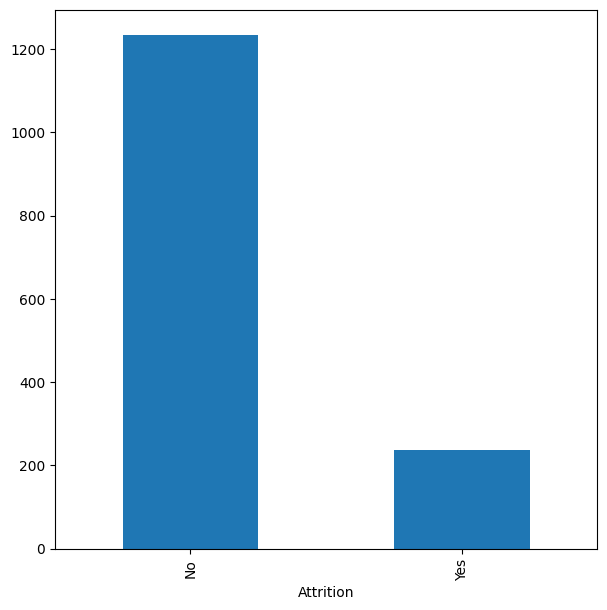

In [16]:
plt.figure(figsize=(7,7))
df.Attrition.value_counts().plot(kind="bar")
plt.show()

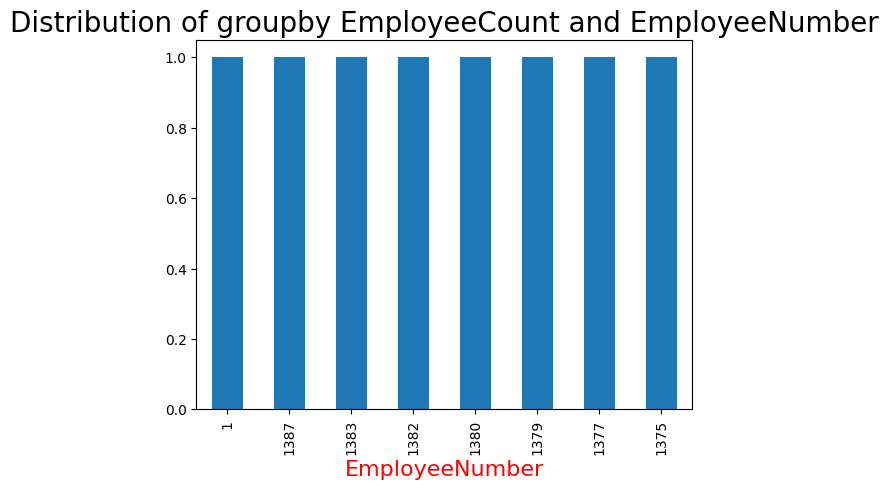

In [17]:
df.groupby("EmployeeNumber")["EmployeeCount"].mean().sort_values().head(8).plot(kind="bar")
plt.title("Distribution of groupby EmployeeCount and EmployeeNumber",c="k",fontsize=20)
plt.xlabel("EmployeeNumber",c="r",fontsize=16)
plt.show()

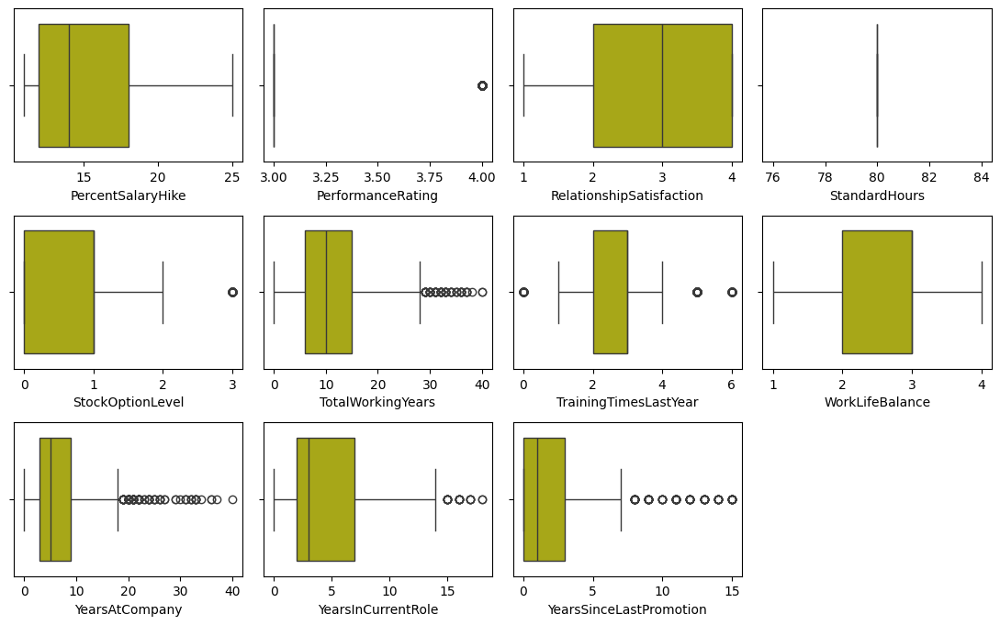

In [18]:
plt.figure(figsize=(11,11))
columns=df.columns[23:34]
for i,column in enumerate(columns,start=1):
    plt.subplot(5,4,i)
    sns.boxplot(x=df[column],color="y")
    
plt.tight_layout()
plt.show()

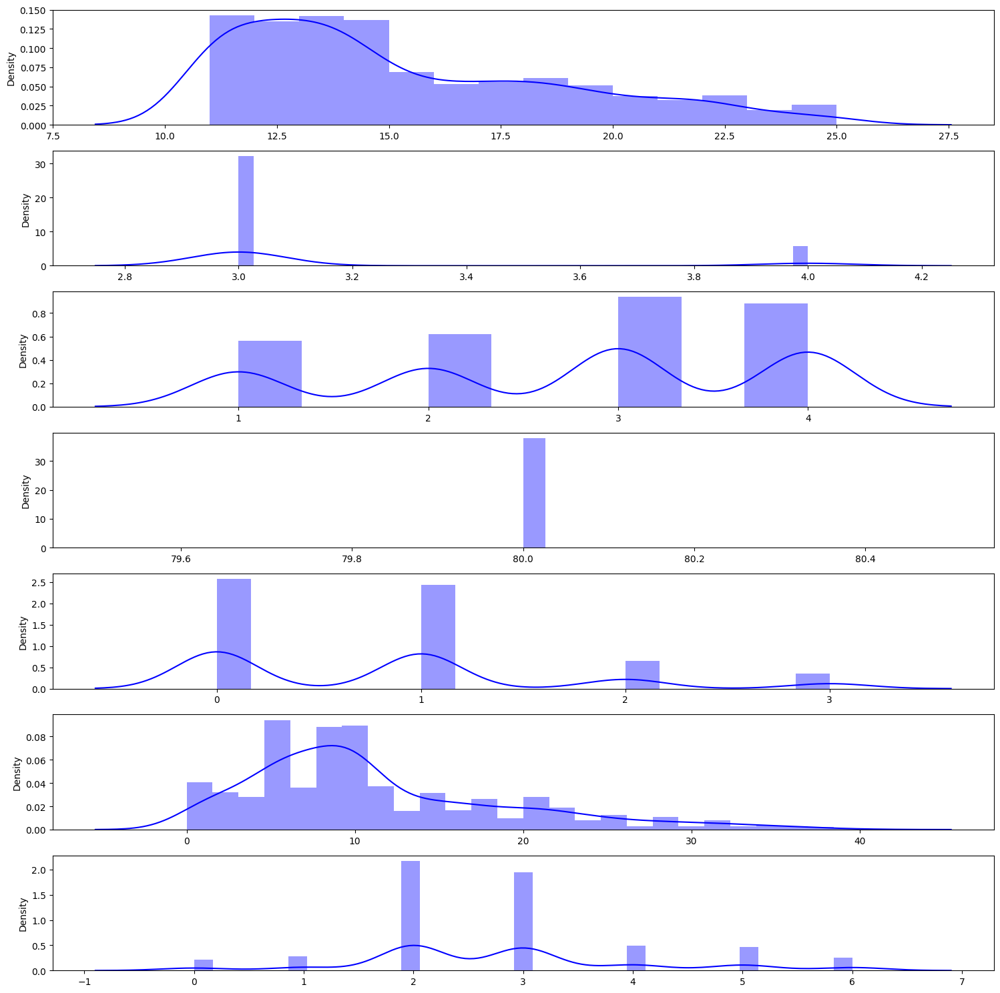

In [19]:
plt.figure(figsize=(15,15))
columns=df.columns[23:30]
for i,column in enumerate(columns,start=1):
    plt.subplot(7,1,i)
    sns.distplot(x=df[column],color="b")
    
plt.tight_layout()
plt.show()

In [20]:
fig=px.histogram(df,x="Education",color="Education")
fig.show()

In [21]:
fig=px.histogram(df,x="Attrition",color="Attrition")
fig.show()

In [22]:
fig=px.histogram(df,x="EducationField",color="EducationField")
fig.show()

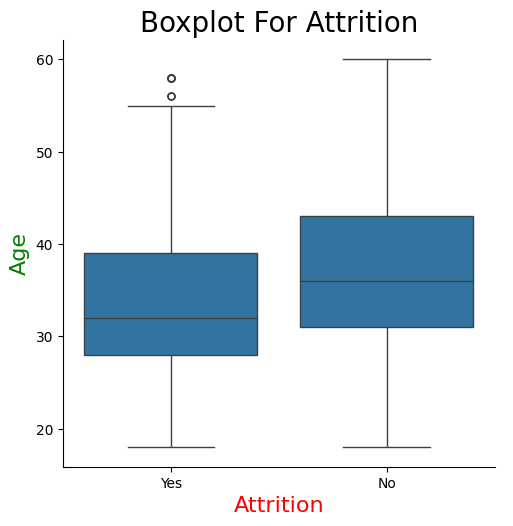

In [23]:
sns.catplot(x="Attrition",y="Age",data=df,kind="box")
plt.title("Boxplot For Attrition",c="k",fontsize=20)
plt.xlabel("Attrition",c="r",fontsize=16)
plt.ylabel("Age",c="g",fontsize=16)
plt.show()

<Axes: title={'center': 'Plotting boxplot to check outliers'}, xlabel='Education', ylabel='outliers'>

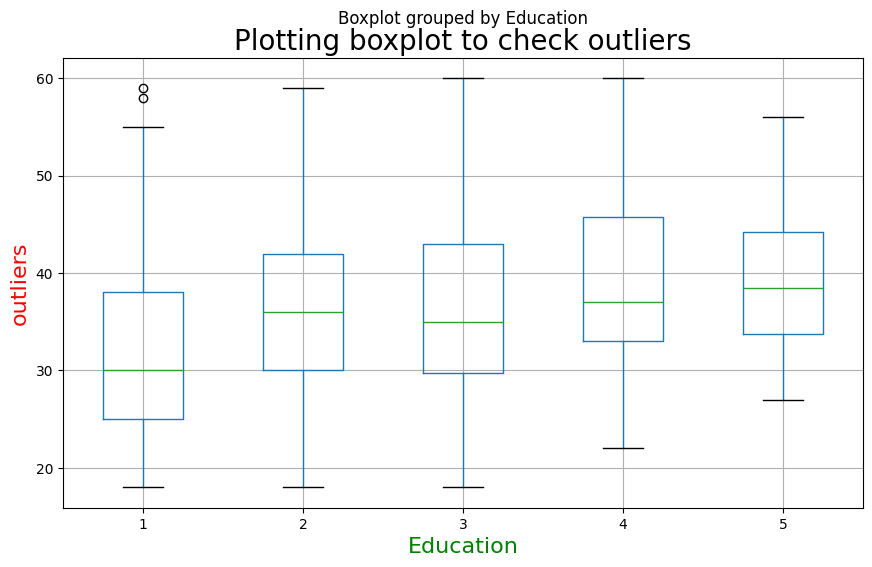

In [24]:
b=df.boxplot(column="Age",by="Education",figsize=(10,6))
plt.title("Plotting boxplot to check outliers",fontsize=20,c="k")
plt.xlabel("Education",fontsize=16,c="g")
plt.ylabel("outliers",fontsize=16,c="r")
b

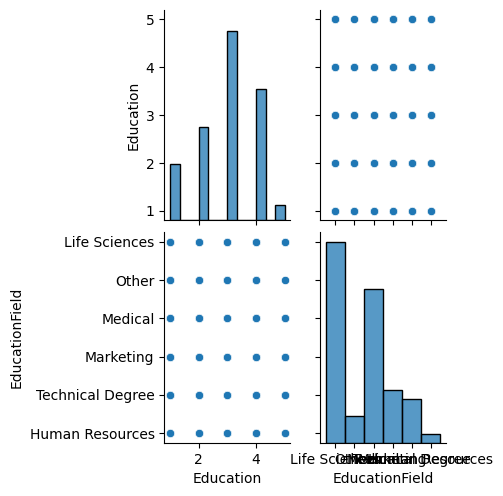

In [25]:
sns.pairplot(df,vars=["Education","EducationField"])
plt.show()

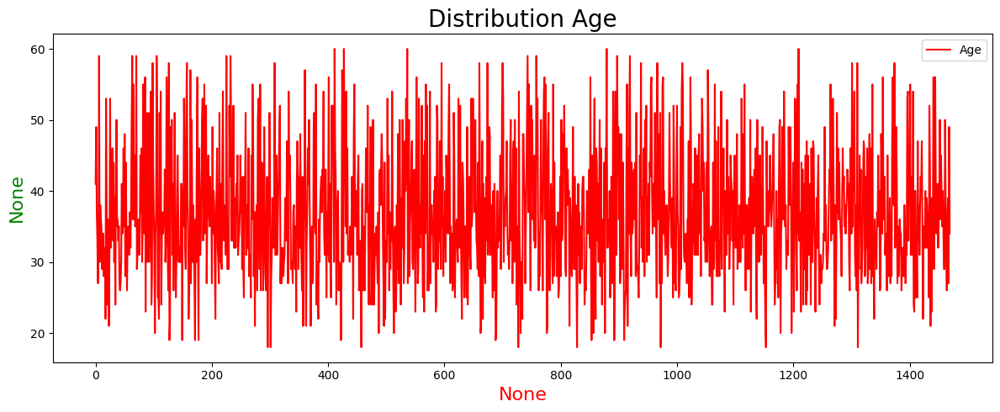

In [26]:
plt.figure(figsize=(12,5))
df["Age"].plot(c="r")
plt.title("Distribution Age",c="k",fontsize=20)
plt.xlabel("None",fontsize=16,c="r")
plt.ylabel("None",fontsize=16,c="g")
plt.legend(["Age"])
plt.tight_layout()
plt.show()

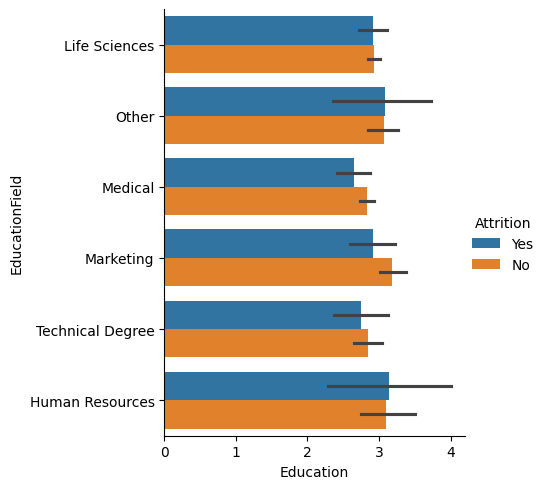

In [27]:
sns.catplot(x="Education",
            y="EducationField",
            hue="Attrition",
            data=df,
            kind="bar")
plt.show()

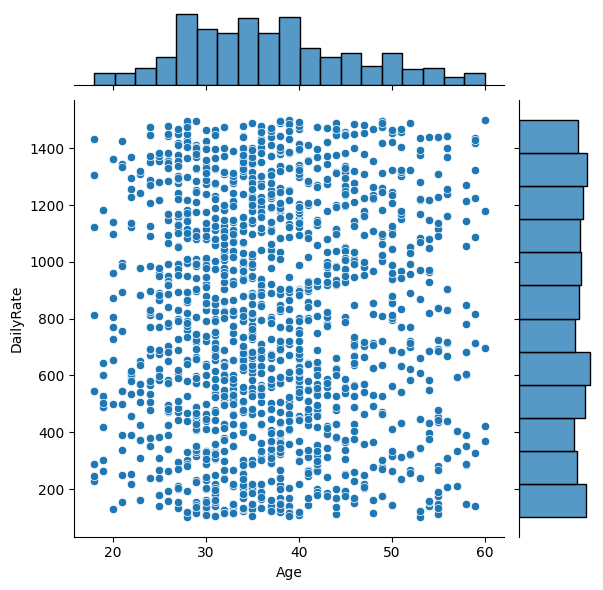

In [28]:
sns.jointplot(x="Age",y="DailyRate",data=df)
plt.show()

### <b><i>  Data Preprocessing

In [29]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [30]:
df.shape

(1470, 35)

In [31]:
df.isna().sum().sum()

0

In [32]:
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [33]:
categoriacal_cols = []
for cols in df.columns:
    if(df[cols].dtype == 'object'):
        categoriacal_cols.append(cols)
print(categoriacal_cols)
print(len(categoriacal_cols))

['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'Over18', 'OverTime']
9


In [34]:
#Unique Values in each categorical columns in the dataset
unique_counts = df[categoriacal_cols].nunique()
print("Number of unique values in each categorical column:")
print(unique_counts)

Number of unique values in each categorical column:
Attrition         2
BusinessTravel    3
Department        3
EducationField    6
Gender            2
JobRole           9
MaritalStatus     3
Over18            1
OverTime          2
dtype: int64


In [35]:
from sklearn.preprocessing import LabelEncoder

# Create a copy of the DataFrame to avoid modifying the original one
df_label_encoded = df.copy()

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Apply LabelEncoder to each categorical column
for col in categoriacal_cols:
    df_label_encoded[col] = label_encoder.fit_transform(df_label_encoded[col])

df_label_encoded.head()


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,2,1102,2,1,2,1,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,0,1,279,1,8,1,1,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,1,2,1373,1,2,2,4,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,0,1,1392,1,3,4,1,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,0,2,591,1,2,1,3,1,7,...,4,80,1,6,3,3,2,2,2,2


In [36]:
## split data to x , y

x=df.drop("Attrition",axis=1)
y=df["Attrition"]

In [37]:
y.value_counts()

Attrition
No     1233
Yes     237
Name: count, dtype: int64

Text(0.5, 1.0, 'Count of the Y')

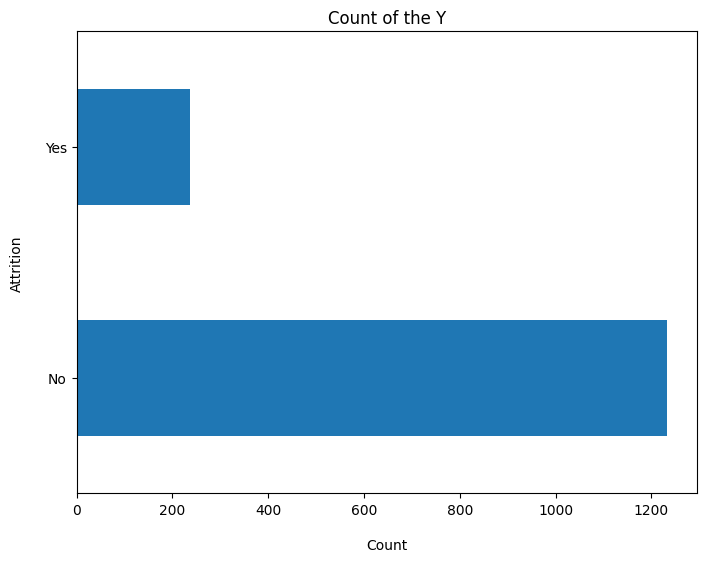

In [38]:
df['Attrition'].value_counts().plot(kind='barh', figsize=(8,6))
plt.xlabel("Count", labelpad=15)
plt.ylabel("Attrition", labelpad=15)
plt.title("Count of the Y")

In [39]:
# List of columns with more than 50% missing values
def columns_with_missing_data(df):
    missing_data_threshold = len(df) * 0.5  # 50% threshold
    missing_columns = []
    for column in df.columns:
        if df[column].isnull().sum() > missing_data_threshold:
            missing_columns.append(column)
    return missing_columns

missing_columns = columns_with_missing_data(df)
print("Columns with more than 50% missing values:")
print(missing_columns)

Columns with more than 50% missing values:
[]


In [40]:
from ydata_profiling import ProfileReport
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## <b><i> Oversampling and Undersampling

In [41]:
df_label_encoded.shape

(1470, 35)

In [42]:
print("Intial Y value count:",y.value_counts())

Intial Y value count: Attrition
No     1233
Yes     237
Name: count, dtype: int64


In [43]:
X_encoded = df_label_encoded.drop("Attrition",axis=1)
y_encoded = df_label_encoded["Attrition"]

In [44]:
# Initialize ADASYN for oversampling
adasyn = ADASYN()
# Initialize TomekLinks for undersampling
tomek_links = TomekLinks()


In [45]:
# Oversample the DataFrame
X_resampled, y_resampled = adasyn.fit_resample(X_encoded, y_encoded) 

# Undersample the oversampled data
X_resampled_tomek, y_resampled_tomek = tomek_links.fit_resample(X_resampled, y_resampled)

### <b> MIC Feature Selection

In [46]:
# 1. MIC Feature Selection

def calculate_mic(X, y):
    mine = MINE()
    mic_scores = []
    for column in X.columns:
        mine.compute_score(X[column], y)
        mic_scores.append(mine.mic())
    return mic_scores

In [47]:
from minepy import MINE

# Initialize the MINE object
mine = MINE()

# Calculate MIC scores
mic_scores = []
for col in X_resampled.columns:
    mine.compute_score(X_resampled[col], y_resampled)
    mic_scores.append((col, mine.mic()))

# Create a DataFrame with MIC scores and sort by score
mic_df = pd.DataFrame(mic_scores, columns=['Feature', 'MIC Score'])
mic_df = mic_df.sort_values(by='MIC Score', ascending=False).reset_index(drop=True)
mic_df['Rank'] = mic_df.index + 1

print(mic_df)

                     Feature  MIC Score  Rank
0              MonthlyIncome   0.171626     1
1                MonthlyRate   0.127803     2
2                  DailyRate   0.107833     3
3             EmployeeNumber   0.103291     4
4           StockOptionLevel   0.102276     5
5       YearsWithCurrManager   0.093119     6
6             JobInvolvement   0.089979     7
7         YearsInCurrentRole   0.083455     8
8            JobSatisfaction   0.081255     9
9          TotalWorkingYears   0.080156    10
10            YearsAtCompany   0.079205    11
11                  JobLevel   0.074777    12
12   EnvironmentSatisfaction   0.073540    13
13            BusinessTravel   0.069364    14
14                       Age   0.060140    15
15                HourlyRate   0.051486    16
16          DistanceFromHome   0.050656    17
17           WorkLifeBalance   0.049084    18
18     TrainingTimesLastYear   0.045965    19
19                 Education   0.045274    20
20  RelationshipSatisfaction   0.0

In [48]:

# Select top features 
top_features = mic_df['Feature'][:25].tolist()
X_selected = X_resampled_tomek[top_features]


In [49]:
X_selected

,MonthlyIncome,MonthlyRate,DailyRate,EmployeeNumber,StockOptionLevel,YearsWithCurrManager,JobInvolvement,YearsInCurrentRole,JobSatisfaction,TotalWorkingYears,...,HourlyRate,DistanceFromHome,WorkLifeBalance,TrainingTimesLastYear,Education,RelationshipSatisfaction,EducationField,PerformanceRating,JobRole,Gender
0,5993,19479,1102,1,0,5,3,4,4,8,...,94,1,1,0,2,1,1,3,7,0
1,5130,24907,279,2,1,7,2,7,2,10,...,61,8,3,3,1,4,1,4,6,1
2,2090,2396,1373,4,0,0,2,0,3,7,...,92,2,3,3,2,2,4,3,2,1
3,2909,23159,1392,5,0,0,3,7,3,8,...,56,3,3,3,4,3,1,3,6,0
4,3468,16632,591,7,1,2,3,2,2,6,...,40,2,3,3,1,4,3,3,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2344,6734,12173,962,1737,0,0,1,0,2,10,...,34,1,3,2,2,2,1,3,7,1
2345,10761,15955,491,1643,0,2,2,1,1,18,...,41,17,2,2,3,2,1,3,7,1
2346,10736,15791,512,1536,0,3,2,1,1,18,...,42,15,2,2,3,2,1,3,7,1
2347,10784,16387,429,2006,1,0,2,2,1,21,...,42,25,3,3,3,2,2,3,6,0


In [50]:
# Split the data
X_train, X_test, y_train, y_test = train_test_split(X_selected, y_resampled_tomek, test_size=0.2, random_state=42)


In [51]:
# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

## <b> Model Training :


<ul>
<li>Multi‑layer perceptron (MLP)
<li>Convolutional neural networks (CNN)
<li>Recurrent neural networks (RNN)
<li> Convolutional Neural Network - Bidirectional Long Short-Term Memory(CNN-BLSTM)

In [52]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv1D, MaxPooling1D, Flatten, LSTM, Bidirectional

# If GPU is available, set memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)


In [53]:

# Function to create and train models
def create_and_train_model(model_func, X_train, y_train, model_name):
    with tf.device('/GPU:0'):
        model = model_func(X_train.shape[1])
        history = model.fit(
            X_train, y_train, 
            epochs=10, 
            batch_size=32, 
            validation_split=0.2,
            verbose=1
        )
    print(f"{model_name} training completed.")
    return model, history


In [54]:
# 1. Multi-layer Perceptron (MLP)

def create_mlp_model(input_shape):
    model = Sequential([
        Dense(64, activation='relu', input_shape=(input_shape,)),
        Dense(32, activation='relu'),
        Dense(16, activation='relu'),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

mlp_model, mlp_history = create_and_train_model(create_mlp_model, X_train_scaled, y_train, "MLP")


Epoch 1/10
47/47 [==============================] - 2s 11ms/step - loss: 0.6034 - accuracy: 0.6806 - val_loss: 0.5163 - val_accuracy: 0.7473
Epoch 2/10
47/47 [==============================] - 0s 4ms/step - loss: 0.4487 - accuracy: 0.8011 - val_loss: 0.4204 - val_accuracy: 0.8032
Epoch 3/10
47/47 [==============================] - 0s 5ms/step - loss: 0.3793 - accuracy: 0.8323 - val_loss: 0.4010 - val_accuracy: 0.8245
Epoch 4/10
47/47 [==============================] - 0s 4ms/step - loss: 0.3459 - accuracy: 0.8596 - val_loss: 0.3932 - val_accuracy: 0.8271
Epoch 5/10
47/47 [==============================] - 0s 4ms/step - loss: 0.3209 - accuracy: 0.8643 - val_loss: 0.3731 - val_accuracy: 0.8404
Epoch 6/10
47/47 [==============================] - 0s 4ms/step - loss: 0.2959 - accuracy: 0.8816 - val_loss: 0.3652 - val_accuracy: 0.8404
Epoch 7/10
47/47 [==============================] - 0s 5ms/step - loss: 0.2723 - accuracy: 0.8916 - val_loss: 0.3661 - val_accuracy: 0.8298
Epoch 8/10
47/47 [=

In [55]:

# 2. Convolutional Neural Network (CNN)
def create_cnn_model(input_shape):
    model = Sequential([
        Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(input_shape, 1)),
        MaxPooling1D(pool_size=2),
        Flatten(),
        Dense(50, activation='relu'),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

X_train_cnn = X_train_scaled.reshape((X_train_scaled.shape[0], X_train_scaled.shape[1], 1))
cnn_model, cnn_history = create_and_train_model(create_cnn_model, X_train_cnn, y_train, "CNN")


Epoch 1/10
47/47 [==============================] - 3s 9ms/step - loss: 0.5107 - accuracy: 0.7545 - val_loss: 0.4677 - val_accuracy: 0.8059
Epoch 2/10
47/47 [==============================] - 0s 5ms/step - loss: 0.4028 - accuracy: 0.8197 - val_loss: 0.4306 - val_accuracy: 0.8085
Epoch 3/10
47/47 [==============================] - 0s 4ms/step - loss: 0.3830 - accuracy: 0.8283 - val_loss: 0.4323 - val_accuracy: 0.8005
Epoch 4/10
47/47 [==============================] - 0s 5ms/step - loss: 0.3655 - accuracy: 0.8357 - val_loss: 0.4131 - val_accuracy: 0.8165
Epoch 5/10
47/47 [==============================] - 0s 4ms/step - loss: 0.3549 - accuracy: 0.8443 - val_loss: 0.4133 - val_accuracy: 0.8138
Epoch 6/10
47/47 [==============================] - 0s 4ms/step - loss: 0.3490 - accuracy: 0.8470 - val_loss: 0.4245 - val_accuracy: 0.8138
Epoch 7/10
47/47 [==============================] - 0s 4ms/step - loss: 0.3390 - accuracy: 0.8456 - val_loss: 0.4090 - val_accuracy: 0.8165
Epoch 8/10
47/47 [==

In [56]:
# 3. Recurrent Neural Network (RNN)
def create_rnn_model(input_shape):
    model = Sequential([
        LSTM(50, activation='relu', input_shape=(input_shape, 1)),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

rnn_model, rnn_history = create_and_train_model(create_rnn_model, X_train_cnn, y_train, "RNN")


Epoch 1/10
47/47 [==============================] - 3s 44ms/step - loss: 0.6442 - accuracy: 0.6919 - val_loss: 0.5510 - val_accuracy: 0.7048
Epoch 2/10
47/47 [==============================] - 2s 39ms/step - loss: 0.5381 - accuracy: 0.7532 - val_loss: 0.5395 - val_accuracy: 0.7261
Epoch 3/10
47/47 [==============================] - 2s 38ms/step - loss: 0.5181 - accuracy: 0.7585 - val_loss: 0.5232 - val_accuracy: 0.7473
Epoch 4/10
47/47 [==============================] - 2s 38ms/step - loss: 0.5086 - accuracy: 0.7565 - val_loss: 0.5131 - val_accuracy: 0.7580
Epoch 5/10
47/47 [==============================] - 2s 41ms/step - loss: 0.5096 - accuracy: 0.7438 - val_loss: 0.5090 - val_accuracy: 0.7447
Epoch 6/10
47/47 [==============================] - 2s 38ms/step - loss: 0.5017 - accuracy: 0.7658 - val_loss: 0.5120 - val_accuracy: 0.7447
Epoch 7/10
47/47 [==============================] - 2s 40ms/step - loss: 0.4980 - accuracy: 0.7565 - val_loss: 0.5036 - val_accuracy: 0.7367
Epoch 8/10
47

In [57]:
# 4. CNN-BLSTM
def create_cnn_blstm_model(input_shape):
    model = Sequential([
        Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(input_shape, 1)),
        MaxPooling1D(pool_size=2),
        Bidirectional(LSTM(50, return_sequences=True)),
        Bidirectional(LSTM(25)),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

cnn_blstm_model, cnn_blstm_history = create_and_train_model(create_cnn_blstm_model, X_train_cnn, y_train, "CNN-BLSTM")


Epoch 1/10
47/47 [==============================] - 6s 37ms/step - loss: 0.5642 - accuracy: 0.7099 - val_loss: 0.5014 - val_accuracy: 0.7606
Epoch 2/10
47/47 [==============================] - 1s 14ms/step - loss: 0.5029 - accuracy: 0.7631 - val_loss: 0.4964 - val_accuracy: 0.7633
Epoch 3/10
47/47 [==============================] - 1s 14ms/step - loss: 0.4964 - accuracy: 0.7685 - val_loss: 0.4860 - val_accuracy: 0.7606
Epoch 4/10
47/47 [==============================] - 1s 13ms/step - loss: 0.4897 - accuracy: 0.7718 - val_loss: 0.4835 - val_accuracy: 0.7686
Epoch 5/10
47/47 [==============================] - 1s 13ms/step - loss: 0.4783 - accuracy: 0.7791 - val_loss: 0.4776 - val_accuracy: 0.7686
Epoch 6/10
47/47 [==============================] - 1s 15ms/step - loss: 0.4822 - accuracy: 0.7691 - val_loss: 0.4754 - val_accuracy: 0.7713
Epoch 7/10
47/47 [==============================] - 1s 13ms/step - loss: 0.4704 - accuracy: 0.7884 - val_loss: 0.4708 - val_accuracy: 0.7739
Epoch 8/10
47

In [58]:
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


# Evaluate models
def evaluate_model(model, X_test, y_test, model_name):
    # Make predictions
    y_pred = model.predict(X_test)
    y_pred_classes = (y_pred > 0.5).astype(int).flatten()
    
    # Calculate metrics
    accuracy = accuracy_score(y_test, y_pred_classes)
    precision = precision_score(y_test, y_pred_classes, average='weighted')
    recall = recall_score(y_test, y_pred_classes, average='weighted')
    f1 = f1_score(y_test, y_pred_classes, average='weighted')
    
    print(f"{model_name} - Test accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")
    
    return accuracy, precision, recall, f1

# Evaluate each model
mlp_metrics = evaluate_model(mlp_model, X_test_scaled, y_test, "MLP")
cnn_metrics = evaluate_model(cnn_model, X_test_scaled, y_test, "CNN")
rnn_metrics = evaluate_model(rnn_model, X_test_scaled, y_test, "RNN")
cnn_blstm_metrics = evaluate_model(cnn_blstm_model, X_test_scaled, y_test, "CNN-BLSTM")


15/15 [==============================] - 0s 1ms/step
MLP - Test accuracy: 0.8362, Precision: 0.8371, Recall: 0.8362, F1 Score: 0.8358
15/15 [==============================] - 0s 2ms/step
CNN - Test accuracy: 0.8213, Precision: 0.8251, Recall: 0.8213, F1 Score: 0.8202
15/15 [==============================] - 0s 5ms/step
RNN - Test accuracy: 0.7681, Precision: 0.7867, Recall: 0.7681, F1 Score: 0.7626
15/15 [==============================] - 1s 6ms/step
CNN-BLSTM - Test accuracy: 0.7681, Precision: 0.7829, Recall: 0.7681, F1 Score: 0.7635


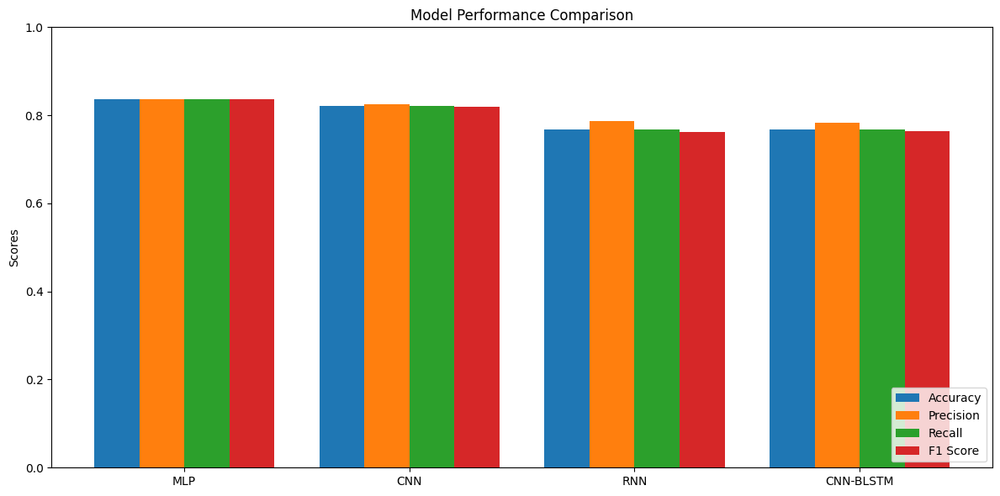

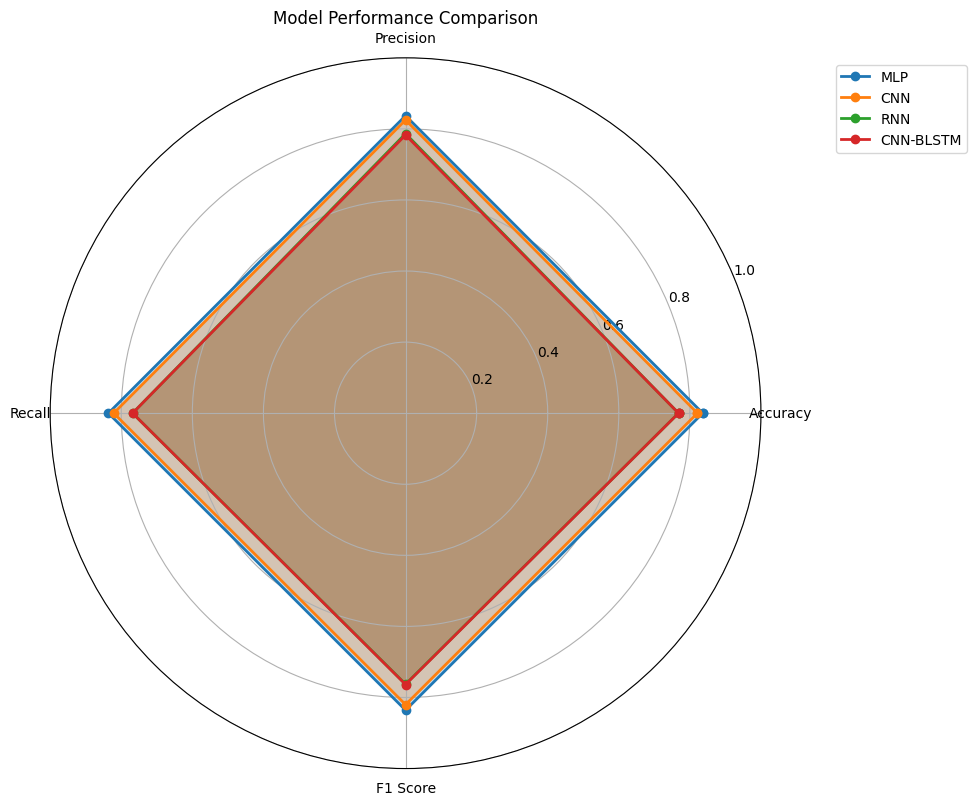

In [59]:

# Create a bar chart to compare metrics
models = ['MLP', 'CNN', 'RNN', 'CNN-BLSTM']
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']

fig, ax = plt.subplots(figsize=(12, 6))

x = np.arange(len(models))
width = 0.2

for i, metric in enumerate(metrics):
    values = [mlp_metrics[i], cnn_metrics[i], rnn_metrics[i], cnn_blstm_metrics[i]]
    ax.bar(x + i*width, values, width, label=metric)

ax.set_ylabel('Scores')
ax.set_title('Model Performance Comparison')
ax.set_xticks(x + width * 1.5)
ax.set_xticklabels(models)
ax.legend(loc='lower right')
ax.set_ylim(0, 1)

plt.tight_layout()
plt.show()

# Create a radar chart to compare models
fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(projection='polar'))

angles = np.linspace(0, 2*np.pi, len(metrics), endpoint=False)
angles = np.concatenate((angles, [angles[0]]))

for model, model_metrics in zip(models, [mlp_metrics, cnn_metrics, rnn_metrics, cnn_blstm_metrics]):
    values = list(model_metrics) + [model_metrics[0]]
    ax.plot(angles, values, 'o-', linewidth=2, label=model)
    ax.fill(angles, values, alpha=0.25)

ax.set_thetagrids(angles[:-1] * 180/np.pi, metrics)
ax.set_ylim(0, 1)
ax.set_title('Model Performance Comparison')
ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.0))

plt.tight_layout()
plt.show()
